<a href="https://colab.research.google.com/github/mikiya1130/world_model/blob/morisaki%2Fmain.py/main.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## 準備

### Google Drive のマウント

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


### git clone

In [2]:
!git clone https://github.com/mikiya1130/world_model.git
%cd world_model

fatal: destination path 'world_model' already exists and is not an empty directory.
/content/world_model


### PyBullet のインストール

In [3]:
!pip install pybullet

### ライブラリのインポート

In [4]:
import time
import os
from cmath import sqrt
import random

import gym
import pybullet_envs  # PyBulletの環境をgymに登録する

import numpy as np
import matplotlib.pyplot as plt
import cv2
import pandas as pd

import torch
from torch.distributions import Normal
from torch.distributions.kl import kl_divergence
from torch import nn
from torch.nn import functional as F
from torch.nn.utils import clip_grad_norm_
from torch.utils.tensorboard import SummaryWriter

# 可視化のためにTensorBoardを用いるので, Colab上でTensorBoardを表示するための宣言を行う
%load_ext tensorboard

### パスの設定

In [5]:
PROJECT_DIR = '/content/drive/MyDrive/world_model'
DATA_DIR = os.path.join(PROJECT_DIR, 'data')
LOG_DIR = os.path.join(PROJECT_DIR, 'logs')

### torch.device の定義

In [6]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)

cuda


## Graph 情報の読み込み

In [7]:
N, M = 927, 1899
Graph_2 = [[] for _ in range(1330)]

file_path = os.path.join(DATA_DIR, 'graph_2.txt')
with open(file_path) as f:
    lines = f.read()
    i = 0
    for line in lines.split("\n"):
        node1, node2, direction = map(int, line.split())
        Graph_2[node1].append((node2, direction))
        i += 1
        if i == M+1:
            break
            
Graph = Graph_2

## 環境の設定

In [8]:
def return_image_and_moveable_node(image, action):
    
    """
    Graph
    input image(node), action
    return image, next_node, and moveable_direction

    """
    # current_node = int(image[:6])
    current_node = image
    moveable_nodes = Graph[current_node]
    # next_node = float('inf')
    next_node = current_node
    
    
    print(f"今のnodeは{current_node}で動ける箇所は{Graph[current_node]}, action: {action}")
    
    for i in moveable_nodes:
        if i[1] == action:
            next_node = i[0]
    
    if next_node == current_node:
        next_node = random.choice([i[0] for i in moveable_nodes])
    
    # next_image = node_int_to_string(next_node) + "_" + str(action) + ".jpg"
    # _next_image = Image.open(next_image)
    
    # ここでappendしてます。外に書いたほうがいいかもしれません。
    # frames.append(_next_image)
    # next_moveable_nodes = Graph[next_node]
    
    # return next_image, next_node, next_moveable_nodes
    return next_node

In [9]:
df_meta = pd.read_csv(os.path.join(DATA_DIR, 'meta.csv'), index_col=0)

def idx_to_coordinate(position):
    x, y = df_meta.iloc[position][:2]
    return x, y

In [10]:
class MyEnv(gym.Env):
    def __init__(self, start_position, direction, goal_position, img_dir):
        ACTION_NUM = 4
        self.action_space = gym.spaces.Discrete(ACTION_NUM) 
        
        LOW = np.zeros((64, 64, 3), dtype=np.float32)
        HIGH = np.full((64, 64, 3), 255, dtype=np.float32)
        self.observation_space = gym.spaces.Box(low=LOW, high=HIGH)

        self.start_position = start_position
        self.direction = direction
        self.goal_position = goal_position
        self.position = None
        self.img_dir = img_dir

        self.reset()

    def reset(self):
        self.position = self.start_position
        observation = self.render(mode="rgb_array")
        return observation

    def step(self, action_index):
        next_position = return_image_and_moveable_node(self.position, action_index)
        reward = self.reward_myenv(self.position, next_position)
        observation = self.render(mode="rgb_array")

        self.position = next_position
        done = next_position == self.goal_position

        return observation, reward, done, {}

    def render(self, mode='human', **kwargs):
        observation = cv2.imread(os.path.join(img_dir, f'{self.position:06}_{direction}.jpg'))
        observation = cv2.cvtColor(observation, cv2.COLOR_BGR2RGB)
        return observation
    
    def reward_myenv(self, position, next_position):
        x, y = idx_to_coordinate(position)
        next_x, next_y = idx_to_coordinate(next_position)
        dest_x, dest_y = idx_to_coordinate(self.goal_position)

        if x != next_x or y != next_y:
            reward_d=((dest_x-x)**2+(dest_y-y)**2)**0.5-((dest_x-next_x)**2+(dest_y-next_y)**2)**0.5
            reward_v=((next_x-x)**2+(next_y-y)**2)**0.5
            reward_d *= 10**4
            reward_v *= 10**4
            reward=reward_d*reward_v
        else:
            reward = -10.0

        return reward 

    def close(self):
        pass

In [11]:
# env = gym.make('HalfCheetahBulletEnv-v0')
# カメラのパラメータを与えてカメラの位置と角度, 画像の大きさを調整
# env = GymWrapper_PyBullet(env, cam_dist=2, cam_pitch=0, render_width=64, render_height=64)
start_position = 264
direction = 1
goal_position = 429
img_dir = os.path.join(DATA_DIR, 'processed')
env = MyEnv(start_position, direction, goal_position, img_dir)

In [12]:
env.action_space

Discrete(4)

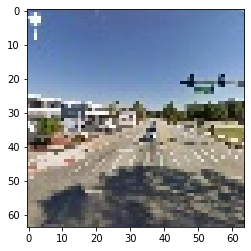

In [13]:
env.reset()
image = env.render(mode='rgb_array')
plt.imshow(image)
plt.show()
env.close()

### 同じ行動を指定された回数自動的に繰り返すラッパー

In [14]:
class RepeatAction(gym.Wrapper):
    """
    同じ行動を指定された回数自動的に繰り返すラッパー. 観測は最後の行動に対応するものになる
    """
    def __init__(self, env, skip=4):
        gym.Wrapper.__init__(self, env)
        self._skip = skip

    def reset(self):
        return self.env.reset()

    def step(self, action):
        total_reward = 0.0
        for _ in range(self._skip):
            obs, reward, done, info = self.env.step(action)
            total_reward += reward
            if done:
                break
        return obs, total_reward, done, info

### 以上をまとめた、学習に用いる環境を作成するための関数

In [15]:
def make_env():
    # env = gym.make('HalfCheetahBulletEnv-v0')  # 環境を読み込む. 今回はHalfCheetah
    # Dreamerでは観測は64x64のRGB画像
    # env = GymWrapper_PyBullet(env, cam_dist=2, cam_pitch=0, render_width=64, render_height=64)
    env = MyEnv(start_position, direction, goal_position, img_dir)
    env = RepeatAction(env, skip=2)  # DreamerではActionRepeatは2
    return env

## RSSM

- 状態遷移を担うクラス（TransitionModel） 
- 観測を復元するデコーダクラス（ObservationModel）
- 報酬を予測するクラス（RewardModel）

### TransitionModel

In [16]:
class TransitionModel(nn.Module):
    """
    このクラスは複数の要素を含んでいます.
    決定的状態遷移 （RNN) : h_t+1 = f(h_t, s_t, a_t)
    確率的状態遷移による1ステップ予測として定義される "prior" : p(s_t+1 | h_t+1)
    観測の情報を取り込んで定義される "posterior": q(s_t+1 | h_t+1, e_t+1)
    """
    def __init__(self, state_dim, action_dim, rnn_hidden_dim,
                 hidden_dim=200, min_stddev=0.1, act=F.elu):
        super(TransitionModel, self).__init__()
        self.state_dim = state_dim
        self.action_dim = action_dim
        self.rnn_hidden_dim = rnn_hidden_dim
        self.fc_state_action = nn.Linear(state_dim + action_dim, hidden_dim)
      
        self.fc_rnn_hidden = nn.Linear(rnn_hidden_dim, hidden_dim)
        self.fc_state_mean_prior = nn.Linear(hidden_dim, state_dim)
        self.fc_state_stddev_prior = nn.Linear(hidden_dim, state_dim)
        self.fc_rnn_hidden_embedded_obs = nn.Linear(rnn_hidden_dim + 1024, hidden_dim)
        self.fc_state_mean_posterior = nn.Linear(hidden_dim, state_dim)
        self.fc_state_stddev_posterior = nn.Linear(hidden_dim, state_dim)

        #next hidden stateを計算
        self.rnn = nn.GRUCell(hidden_dim, rnn_hidden_dim)
        self._min_stddev = min_stddev
        self.act = act

    def forward(self, state, action, rnn_hidden, embedded_next_obs):
        """
        h_t+1 = f(h_t, s_t, a_t)
        prior p(s_t+1 | h_t+1) と posterior q(s_t+1 | h_t+1, e_t+1) を返す
        この2つが近づくように学習する
        """
        next_state_prior, rnn_hidden = self.prior(self.reccurent(state, action, rnn_hidden))
        next_state_posterior = self.posterior(rnn_hidden, embedded_next_obs)
        return next_state_prior, next_state_posterior, rnn_hidden
      
    def reccurent(self, state, action, rnn_hidden):
        """
        h_t+1 = f(h_t, s_t, a_t)を計算する
        """
        hidden = self.act(self.fc_state_action(torch.cat([state, action], dim=1)))
        #h_t+1を求める
        rnn_hidden = self.rnn(hidden, rnn_hidden)
        return rnn_hidden

    def prior(self, rnn_hidden):
        """
        prior p(s_t+1 | h_t+1) を計算する
        """
        #h_t+1を求める
        hidden = self.act(self.fc_rnn_hidden(rnn_hidden))

        mean = self.fc_state_mean_prior(hidden)
        stddev = F.softplus(self.fc_state_stddev_prior(hidden)) + self._min_stddev
        return Normal(mean, stddev), rnn_hidden

    def posterior(self, rnn_hidden, embedded_obs):
        """
        posterior q(s_t+1 | h_t+1, e_t+1)  を計算する
        """
        # h_t+1, o_t+1を結合し, q(s_t+1 | h_t+1, e_t+1) を計算する
        hidden = self.act(self.fc_rnn_hidden_embedded_obs(
            torch.cat([rnn_hidden, embedded_obs], dim=1)))
        mean = self.fc_state_mean_posterior(hidden)
        stddev = F.softplus(self.fc_state_stddev_posterior(hidden)) + self._min_stddev
        return Normal(mean, stddev)

### ObservationModel

In [17]:
class ObservationModel(nn.Module):
    """
    p(o_t | s_t, h_t)
    低次元の状態表現から画像を再構成するデコーダ (3, 64, 64)
    """
    def __init__(self, state_dim, rnn_hidden_dim):
        super(ObservationModel, self).__init__()
        self.fc = nn.Linear(state_dim + rnn_hidden_dim, 1024)
        self.dc1 = nn.ConvTranspose2d(1024, 128, kernel_size=5, stride=2)
        self.dc2 = nn.ConvTranspose2d(128, 64, kernel_size=5, stride=2)
        self.dc3 = nn.ConvTranspose2d(64, 32, kernel_size=6, stride=2)
        self.dc4 = nn.ConvTranspose2d(32, 3, kernel_size=6, stride=2)


    def forward(self, state, rnn_hidden):
        hidden = self.fc(torch.cat([state, rnn_hidden], dim=1))
        hidden = hidden.view(hidden.size(0), 1024, 1, 1)
        hidden = F.relu(self.dc1(hidden))
        hidden = F.relu(self.dc2(hidden))
        hidden = F.relu(self.dc3(hidden))
        obs = self.dc4(hidden)
        return obs

### RewardModel

In [18]:
class RewardModel(nn.Module):
    """
    p(r_t | s_t, h_t)
    低次元の状態表現から報酬を予測する
    """
    def __init__(self, state_dim, rnn_hidden_dim, hidden_dim=400, act=F.elu):
        super(RewardModel, self).__init__()
        self.fc1 = nn.Linear(state_dim + rnn_hidden_dim, hidden_dim)
        self.fc2 = nn.Linear(hidden_dim, hidden_dim)
        self.fc3 = nn.Linear(hidden_dim, hidden_dim)
        self.fc4 = nn.Linear(hidden_dim, 1)
        self.act = act
 

    def forward(self, state, rnn_hidden):
        hidden = self.act(self.fc1(torch.cat([state, rnn_hidden], dim=1)))
        hidden = self.act(self.fc2(hidden))
        hidden = self.act(self.fc3(hidden))
        reward = self.fc4(hidden)
        return reward

### RSSM クラス



In [19]:
class RSSM:
    def __init__(self, state_dim, action_dim, rnn_hidden_dim, ):
        self.transition = TransitionModel(state_dim, action_dim, rnn_hidden_dim).to(device)
        self.observation = ObservationModel(state_dim, rnn_hidden_dim,).to(device)
        self.reward = RewardModel(state_dim, rnn_hidden_dim,).to(device)

## 補助機能

- ReplayBuffer
- 観測の前処理を行う関数
- λ-returnを計算する関数

### ReplayBuffer

In [20]:
class ReplayBuffer(object):
    """
    RNNを用いて訓練するのに適したリプレイバッファ
    """
    def __init__(self, capacity, observation_shape, action_dim):
        self.capacity = capacity

        self.observations = np.zeros((capacity, *observation_shape), dtype=np.uint8)
        self.actions = np.zeros((capacity, action_dim), dtype=np.float32)
        self.rewards = np.zeros((capacity, 1), dtype=np.float32)
        self.done = np.zeros((capacity, 1), dtype=np.bool)

        self.index = 0
        self.is_filled = False

    def push(self, observation, action, reward, done):
        """
        リプレイバッファに経験を追加する
        """
        self.observations[self.index] = observation
        self.actions[self.index] = action
        self.rewards[self.index] = reward
        self.done[self.index] = done

        # indexは巡回し, 最も古い経験を上書きする
        if self.index == self.capacity - 1:
            self.is_filled = True
        self.index = (self.index + 1) % self.capacity

    def sample(self, batch_size, chunk_length):
        """
        経験をリプレイバッファからサンプルします. （ほぼ）一様なサンプルです
        結果として返ってくるのは観測(画像), 行動, 報酬, 終了シグナルについての(batch_size, chunk_length, 各要素の次元)の配列です
        各バッチは連続した経験になっています
        注意: chunk_lengthをあまり大きな値にすると問題が発生する場合があります
        """
        episode_borders = np.where(self.done)[0]
        sampled_indexes = []
        for _ in range(batch_size):
            cross_border = True
            while cross_border:
                initial_index = np.random.randint(len(self) - chunk_length + 1)
                final_index = initial_index + chunk_length - 1
                cross_border = np.logical_and(initial_index <= episode_borders,
                                              episode_borders < final_index).any()#論理積
            sampled_indexes += list(range(initial_index, final_index + 1))

        sampled_observations = self.observations[sampled_indexes].reshape(
            batch_size, chunk_length, *self.observations.shape[1:])
        sampled_actions = self.actions[sampled_indexes].reshape(
            batch_size, chunk_length, self.actions.shape[1])
        sampled_rewards = self.rewards[sampled_indexes].reshape(
            batch_size, chunk_length, 1)
        sampled_done = self.done[sampled_indexes].reshape(
            batch_size, chunk_length, 1)
        return sampled_observations, sampled_actions, sampled_rewards, sampled_done

    def __len__(self):
        return self.capacity if self.is_filled else self.index

### 観測の前処理を行う関数

In [21]:
def preprocess_obs(obs):
    """
    画像の変換. [0, 255] -> [-0.5, 0.5]
    """
    obs = obs.astype(np.float32)
    normalized_obs = obs / 255.0 - 0.5
    return normalized_obs

### λ-returnを計算する関数

In [22]:
def lambda_target(rewards, values, gamma, lambda_):
    """
    価値関数の学習のためのλ-returnを計算します
    """
    V_lambda = torch.zeros_like(rewards, device=rewards.device)

    H = rewards.shape[0] - 1
    V_n = torch.zeros_like(rewards, device=rewards.device)
    V_n[H] = values[H]
    for n in range(1, H+1):
        # まずn-step returnを計算します
        # 注意: 系列が途中で終わってしまったら, 可能な中で最大のnを用いたn-stepを使います
        V_n[:-n] = (gamma ** n) * values[n:]
        for k in range(1, n+1):
            if k == n:
                V_n[:-n] += (gamma ** (n-1)) * rewards[k:]
            else:
                V_n[:-n] += (gamma ** (k-1)) * rewards[k:-n+k]

        # lambda_でn-step returnを重みづけてλ-returnを計算します
        if n == H:
            V_lambda += (lambda_ ** (H-1)) * V_n
        else:
            V_lambda += (1 - lambda_) * (lambda_ ** (n-1)) * V_n

    return V_lambda

## Dreamer
- 観測の画像をベクトルに変換するエンコーダクラス（Encoder）
- 価値関数を計算するクラス（ValueModel）
- 実際に行動を決定するクラス（ActionModel）


### Encoder

In [23]:
class Encoder(nn.Module):
    """
    (3, 64, 64)の画像を(1024,)のベクトルに変換するエンコーダ
    """
    def __init__(self):
        super(Encoder, self).__init__()
        self.cv1 = nn.Conv2d(3, 32, kernel_size=4, stride=2)
        self.cv2 = nn.Conv2d(32, 64, kernel_size=4, stride=2)
        self.cv3 = nn.Conv2d(64, 128, kernel_size=4, stride=2)
        self.cv4 = nn.Conv2d(128, 256, kernel_size=4, stride=2)

    def forward(self, obs):
        hidden = F.relu(self.cv1(obs))
        hidden = F.relu(self.cv2(hidden))
        hidden = F.relu(self.cv3(hidden))
        embedded_obs = F.relu(self.cv4(hidden)).reshape(hidden.size(0), -1)
        return embedded_obs

### ValueModel

In [24]:
class ValueModel(nn.Module):
    """
    低次元の状態表現(state_dim + rnn_hidden_dim)から状態価値を出力する
    """
    def __init__(self, state_dim, rnn_hidden_dim, hidden_dim=400, act=F.elu):
        super(ValueModel, self).__init__()
        self.fc1 = nn.Linear(state_dim + rnn_hidden_dim, hidden_dim)
        self.fc2 = nn.Linear(hidden_dim, hidden_dim)
        self.fc3 = nn.Linear(hidden_dim, hidden_dim)
        self.fc4 = nn.Linear(hidden_dim, 1)
        self.act = act

    def forward(self, state, rnn_hidden):
        hidden = self.act(self.fc1(torch.cat([state, rnn_hidden], dim=1)))
        hidden = self.act(self.fc2(hidden))
        hidden = self.act(self.fc3(hidden))
        state_value = self.fc4(hidden)
        return state_value

### ActionModel

In [25]:
class ActionModel(nn.Module):
    """
    低次元の状態表現(state_dim + rnn_hidden_dim)から行動を計算するクラス
    """
    def __init__(self, state_dim, rnn_hidden_dim, action_dim,
                 hidden_dim=400, act=F.elu, min_stddev=1e-4, init_stddev=5.0):
        super(ActionModel, self).__init__()
        self.fc1 = nn.Linear(state_dim + rnn_hidden_dim, hidden_dim)
        self.fc2 = nn.Linear(hidden_dim, hidden_dim)
        self.fc3 = nn.Linear(hidden_dim, hidden_dim)
        self.fc4 = nn.Linear(hidden_dim, hidden_dim)
        self.fc_mean = nn.Linear(hidden_dim, action_dim)
        self.fc_stddev = nn.Linear(hidden_dim, action_dim)
        self.act = act
        self.min_stddev = min_stddev
        self.init_stddev = np.log(np.exp(init_stddev) - 1)

    def forward(self, state, rnn_hidden, training=True):
        """
        training=Trueなら, NNのパラメータに関して微分可能な形の行動のサンプル（Reparametrizationによる）を返します
        training=Falseなら, 行動の確率分布の平均値を返します
        """
        hidden = self.act(self.fc1(torch.cat([state, rnn_hidden], dim=1)))
        hidden = self.act(self.fc2(hidden))
        hidden = self.act(self.fc3(hidden))
        hidden = self.act(self.fc4(hidden))

        # Dreamerの実装に合わせて少し平均と分散に対する簡単な変換が入っています
        mean = self.fc_mean(hidden)
        mean = 5.0 * torch.tanh(mean / 5.0)
        stddev = self.fc_stddev(hidden)
        stddev = F.softplus(stddev + self.init_stddev) + self.min_stddev

        if training:
            action = torch.tanh(Normal(mean, stddev).rsample())#微分可能にするためrsample()
        else:
            action = torch.tanh(mean)
        return action

## Agent

In [26]:
class Agent:
    """
    ActionModelに基づき行動を決定する. そのためにRSSMを用いて状態表現をリアルタイムで推論して維持するクラス
    """
    def __init__(self, encoder, rssm, action_model):
        self.encoder = encoder
        self.rssm = rssm
        self.action_model = action_model

        self.device = next(self.action_model.parameters()).device
        self.rnn_hidden = torch.zeros(1, rssm.rnn_hidden_dim, device=self.device)

    def __call__(self, obs, training=True):
        # preprocessを適用, PyTorchのためにChannel-Firstに変換
        obs = preprocess_obs(obs)
        obs = torch.as_tensor(obs, device=self.device)
        obs = obs.transpose(1, 2).transpose(0, 1).unsqueeze(0)

        with torch.no_grad():
            # 観測を低次元の表現に変換し, posteriorからのサンプルをActionModelに入力して行動を決定する
            embedded_obs = self.encoder(obs)
            state_posterior = self.rssm.posterior(self.rnn_hidden, embedded_obs)
            state = state_posterior.sample()
            action = self.action_model(state, self.rnn_hidden, training=training)

            # 次のステップのためにRNNの隠れ状態を更新しておく
            _, self.rnn_hidden = self.rssm.prior(self.rssm.reccurent(state, action, self.rnn_hidden))

        return action.squeeze().cpu().numpy()

    #RNNの隠れ状態をリセット
    def reset(self):
        self.rnn_hidden = torch.zeros(1, self.rssm.rnn_hidden_dim, device=self.device)

## ハイパーパラメータの設定と学習の準備

In [27]:
# リプレイバッファの宣言
buffer_capacity = 200000  # Colabのメモリの都合上, 元の実装より小さめにとっています
replay_buffer = ReplayBuffer(capacity=buffer_capacity,
                              observation_shape=env.observation_space.shape,
                              action_dim=4)
                            #   action_dim=env.action_space.shape[0])

# モデルの宣言
state_dim = 30  # 確率的状態の次元
rnn_hidden_dim = 200  # 決定的状態（RNNの隠れ状態）の次元
#確率的状態の次元と決定的状態（RNNの隠れ状態）の次元は一致しなくて良い
encoder = Encoder().to(device)
# rssm = RSSM(state_dim,env.action_space.shape[0],rnn_hidden_dim, )
rssm = RSSM(state_dim,4,rnn_hidden_dim, )
value_model = ValueModel(state_dim, rnn_hidden_dim).to(device)
action_model = ActionModel(state_dim, rnn_hidden_dim, 4).to(device)
                            #  env.action_space.shape[0]).to(device)

# オプティマイザの宣言
model_lr = 6e-4  # encoder, rssm, obs_model, reward_modelの学習率
value_lr = 8e-5
action_lr = 8e-5
eps = 1e-4
model_params = (list(encoder.parameters()) +
                  list(rssm.transition.parameters()) +
                  list(rssm.observation.parameters()) +
                  list(rssm.reward.parameters()))
model_optimizer = torch.optim.Adam(model_params, lr=model_lr, eps=eps)
value_optimizer = torch.optim.Adam(value_model.parameters(), lr=value_lr, eps=eps)
action_optimizer = torch.optim.Adam(action_model.parameters(), lr=action_lr, eps=eps)

# その他ハイパーパラメータ
seed_episodes = 5  # 最初にランダム行動で探索するエピソード数
all_episodes = 10  # 学習全体のエピソード数（300ほどで, ある程度収束します）
test_interval = 10  # 何エピソードごとに探索ノイズなしのテストを行うか
model_save_interval = 10  # NNの重みを何エピソードごとに保存するか
collect_interval = 100  # 何回のNNの更新ごとに経験を集めるか（＝1エピソード経験を集めるごとに何回更新するか）

action_noise_var = 0.3  # 探索ノイズの強さ

batch_size = 50
chunk_length = 50  # 1回の更新で用いる系列の長さ
imagination_horizon = 15  # Actor-Criticの更新のために, Dreamerで何ステップ先までの想像上の軌道を生成するか


gamma = 0.9  # 割引率
lambda_ = 0.95  # λ-returnのパラメータ
clip_grad_norm = 100  # gradient clippingの値
free_nats = 3  # KL誤差（RSSMのTransitionModelにおけるpriorとposteriorの間の誤差）がこの値以下の場合, 無視する

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  # This is added back by InteractiveShellApp.init_path()


## 学習

### 事前の経験の蓄積

- ランダムに行動して経験をリプレイバッファに貯める

In [28]:
env = make_env()
print(vars(env))
print(type(env.action_space))

{'env': <__main__.MyEnv object at 0x7fafe9fb7110>, 'action_space': Discrete(4), 'observation_space': Box(0.0, 255.0, (64, 64, 3), float32), 'reward_range': (-inf, inf), 'metadata': {'render.modes': []}, '_skip': 2}
<class 'gym.spaces.discrete.Discrete'>


In [29]:
env = make_env()
for episode in range(seed_episodes):
    obs = env.reset()
    done = False
    while not done:
        action = env.action_space.sample()
        next_obs, reward, done, _ = env.step(action)
        replay_buffer.push(obs, action, reward, done)
        obs = next_obs

今のnodeは264で動ける箇所は[(421, 1), (263, 4)], action: 2
今のnodeは263で動ける箇所は[(264, 0), (262, 4)], action: 2
今のnodeは262で動ける箇所は[(263, 0), (261, 4)], action: 0
今のnodeは263で動ける箇所は[(264, 0), (262, 4)], action: 0
今のnodeは264で動ける箇所は[(421, 1), (263, 4)], action: 3
今のnodeは421で動ける箇所は[(422, 1), (264, 3)], action: 3
今のnodeは264で動ける箇所は[(421, 1), (263, 4)], action: 0
今のnodeは421で動ける箇所は[(422, 1), (264, 3)], action: 0
今のnodeは422で動ける箇所は[(423, 1), (421, 3)], action: 1
今のnodeは423で動ける箇所は[(424, 1), (422, 3)], action: 1
今のnodeは424で動ける箇所は[(425, 1), (423, 3)], action: 1
今のnodeは425で動ける箇所は[(426, 1), (424, 3)], action: 1
今のnodeは426で動ける箇所は[(427, 1), (425, 3)], action: 0
今のnodeは425で動ける箇所は[(426, 1), (424, 3)], action: 0
今のnodeは424で動ける箇所は[(425, 1), (423, 3)], action: 3
今のnodeは423で動ける箇所は[(424, 1), (422, 3)], action: 3
今のnodeは422で動ける箇所は[(423, 1), (421, 3)], action: 2
今のnodeは423で動ける箇所は[(424, 1), (422, 3)], action: 2
今のnodeは422で動ける箇所は[(423, 1), (421, 3)], action: 2
今のnodeは423で動ける箇所は[(424, 1), (422, 3)], action: 2
今のnodeは422で動ける箇所は[(4

### TensorBoard

- 学習結果の確認用

In [30]:
writer = SummaryWriter(LOG_DIR)

### メインループ

In [31]:
env = make_env()
for episode in range(seed_episodes, all_episodes):
    # -----------------------------
    #      経験を集める
    # -----------------------------
    start = time.time()
    # 行動を決定するためのエージェントを宣言
    policy = Agent(encoder, rssm.transition, action_model)

    obs = env.reset()
    done = False
    total_reward = 0
    while not done:
        action = policy(obs)
        action = np.argmax(action)
        # 探索のためにランダムな移動を行う
        if np.random.rand() < 0.1:
            action = np.random.randint(4)
        next_obs, reward, done, _ = env.step(action)
        
        #リプレイバッファに観測, 行動, 報酬, doneを格納
        replay_buffer.push(obs, action, reward, done)
        
        obs = next_obs
        total_reward += reward

    # 訓練時の報酬と経過時間をログとして表示
    writer.add_scalar('total reward at train', total_reward, episode)
    print('episode [%4d/%4d] is collected. Total reward is %f' %
            (episode+1, all_episodes, total_reward))
    print('elasped time for interaction: %.2fs' % (time.time() - start))

    # NNのパラメータを更新する
    start = time.time()
    for update_step in range(collect_interval):
        # -------------------------------------------------------------------------------------
        #  RSSM(trainsition_model, obs_model, reward_model)の更新 - Dynamics learning
        # -------------------------------------------------------------------------------------
        observations, actions, rewards, _ = \
            replay_buffer.sample(batch_size, chunk_length)

        # 観測を前処理し, RNNを用いたPyTorchでの学習のためにTensorの次元を調整
        observations = preprocess_obs(observations)
        observations = torch.as_tensor(observations, device=device)
        observations = observations.transpose(3, 4).transpose(2, 3)
        observations = observations.transpose(0, 1)
        actions = torch.as_tensor(actions, device=device).transpose(0, 1)
        rewards = torch.as_tensor(rewards, device=device).transpose(0, 1)

        # 観測をエンコーダで低次元のベクトルに変換
        embedded_observations = encoder(
            observations.reshape(-1, 3, 64, 64)).view(chunk_length, batch_size, -1)

        # 低次元の状態表現を保持しておくためのTensorを定義
        states = torch.zeros(chunk_length, batch_size, state_dim, device=device)
        rnn_hiddens = torch.zeros(chunk_length, batch_size, rnn_hidden_dim, device=device)

        # 低次元の状態表現は最初はゼロ初期化（timestep１つ分）
        state = torch.zeros(batch_size, state_dim, device=device)
        rnn_hidden = torch.zeros(batch_size, rnn_hidden_dim, device=device)

        # 状態s_tの予測を行ってそのロスを計算する（priorとposteriorの間のKLダイバージェンス）
        kl_loss = 0
        for l in range(chunk_length-1):
            next_state_prior, next_state_posterior, rnn_hidden = \
                rssm.transition(state, actions[l], rnn_hidden, embedded_observations[l+1])
            state = next_state_posterior.rsample()
            states[l+1] = state
            rnn_hiddens[l+1] = rnn_hidden
            kl = kl_divergence(next_state_prior, next_state_posterior).sum(dim=1)
            kl_loss += kl.clamp(min=free_nats).mean()  # 原論文通り, KL誤差がfree_nats以下の時は無視
        kl_loss /= (chunk_length - 1)

        # states[0] and rnn_hiddens[0]はゼロ初期化なので以降では使わない
        # states, rnn_hiddensは低次元の状態表現
        states = states[1:]
        rnn_hiddens = rnn_hiddens[1:]

        # 観測を再構成, また, 報酬を予測
        flatten_states = states.view(-1, state_dim)
        flatten_rnn_hiddens = rnn_hiddens.view(-1, rnn_hidden_dim)
        recon_observations = rssm.observation(flatten_states, flatten_rnn_hiddens).view(chunk_length-1, batch_size, 3, 64, 64)
        predicted_rewards = rssm.reward(flatten_states, flatten_rnn_hiddens).view(chunk_length-1, batch_size, 1)

        # 観測と報酬の予測誤差を計算
        obs_loss = 0.5 * F.mse_loss(recon_observations, observations[1:], reduction='none').mean([0, 1]).sum()
        reward_loss = 0.5 * F.mse_loss(predicted_rewards, rewards[:-1])

        # 以上のロスを合わせて勾配降下で更新する
        model_loss = kl_loss + obs_loss + reward_loss
        model_optimizer.zero_grad()
        model_loss.backward()
        clip_grad_norm_(model_params, clip_grad_norm)
        model_optimizer.step()

        # --------------------------------------------------
        #  Action Model, Value Modelの更新　- Behavior leaning
        # --------------------------------------------------
        # Actor-Criticのロスで他のモデルを更新することはないので勾配の流れを一度遮断
        # flatten_states, flatten_rnn_hiddensは RSSMから得られた低次元の状態表現を平坦化した値
        flatten_states = flatten_states.detach()
        flatten_rnn_hiddens = flatten_rnn_hiddens.detach()

        # DreamerにおけるActor-Criticの更新のために, 現在のモデルを用いた
        # 数ステップ先の未来の状態予測を保持するためのTensorを用意
        imaginated_states = torch.zeros(imagination_horizon + 1,
                                         *flatten_states.shape,
                                          device=flatten_states.device)
        imaginated_rnn_hiddens = torch.zeros(imagination_horizon + 1,
                                                *flatten_rnn_hiddens.shape,
                                                device=flatten_rnn_hiddens.device)

        #　未来予測をして想像上の軌道を作る前に, 最初の状態としては先ほどモデルの更新で使っていた
        # リプレイバッファからサンプルされた観測データを取り込んだ上で推論した状態表現を使う
        imaginated_states[0] = flatten_states
        imaginated_rnn_hiddens[0] = flatten_rnn_hiddens
        
        # open-loopで未来の状態予測を使い, 想像上の軌道を作る
        for h in range(1, imagination_horizon + 1):
            # 行動はActionModelで決定. この行動はモデルのパラメータに対して微分可能で,
            #　これを介してActionModelは更新される
            actions = action_model(flatten_states, flatten_rnn_hiddens)
            flatten_states_prior, flatten_rnn_hiddens = rssm.transition.prior(rssm.transition.reccurent(flatten_states,
                                                                   actions,
                                                                   flatten_rnn_hiddens))
            flatten_states = flatten_states_prior.rsample()
            imaginated_states[h] = flatten_states
            imaginated_rnn_hiddens[h] = flatten_rnn_hiddens

        # RSSMのreward_modelにより予測された架空の軌道に対する報酬を計算
        flatten_imaginated_states = imaginated_states.view(-1, state_dim)
        flatten_imaginated_rnn_hiddens = imaginated_rnn_hiddens.view(-1, rnn_hidden_dim)
        imaginated_rewards = \
            rssm.reward(flatten_imaginated_states,
                        flatten_imaginated_rnn_hiddens).view(imagination_horizon + 1, -1)
        imaginated_values = \
            value_model(flatten_imaginated_states,
                        flatten_imaginated_rnn_hiddens).view(imagination_horizon + 1, -1)

        # λ-returnのターゲットを計算(V_{\lambda}(s_{\tau})
        lambda_target_values = lambda_target(imaginated_rewards, imaginated_values, gamma, lambda_)

        # 価値関数の予測した価値が大きくなるようにActionModelを更新
        # PyTorchの基本は勾配降下だが, 今回は大きくしたいので-1をかける
        action_loss = -lambda_target_values.mean()
        action_optimizer.zero_grad()
        action_loss.backward()
        clip_grad_norm_(action_model.parameters(), clip_grad_norm)
        action_optimizer.step()
        
        # TD(λ)ベースの目的関数で価値関数を更新（価値関数のみを学習するため，学習しない変数のグラフは切っている. )
        imaginated_values = value_model(flatten_imaginated_states.detach(), flatten_imaginated_rnn_hiddens.detach()).view(imagination_horizon + 1, -1)        
        value_loss = 0.5 * F.mse_loss(imaginated_values, lambda_target_values.detach())
        value_optimizer.zero_grad()
        value_loss.backward()
        clip_grad_norm_(value_model.parameters(), clip_grad_norm)
        value_optimizer.step()

        # ログをTensorBoardに出力
        print('update_step: %3d model loss: %.5f, kl_loss: %.5f, '
             'obs_loss: %.5f, reward_loss: %.5f, '
             'value_loss: %.5f action_loss: %.5f'
                % (update_step + 1, model_loss.item(), kl_loss.item(),
                    obs_loss.item(), reward_loss.item(),
                    value_loss.item(), action_loss.item()))
        total_update_step = episode * collect_interval + update_step
        writer.add_scalar('model loss', model_loss.item(), total_update_step)
        writer.add_scalar('kl loss', kl_loss.item(), total_update_step)
        writer.add_scalar('obs loss', obs_loss.item(), total_update_step)
        writer.add_scalar('reward loss', reward_loss.item(), total_update_step)
        writer.add_scalar('value loss', value_loss.item(), total_update_step)
        writer.add_scalar('action loss', action_loss.item(), total_update_step)

    print('elasped time for update: %.2fs' % (time.time() - start))

    # --------------------------------------------------------------
    #    テストフェーズ. 探索ノイズなしでの性能を評価する
    # --------------------------------------------------------------
    if (episode + 1) % test_interval == 0:
        policy = Agent(encoder, rssm.transition, action_model)
        start = time.time()
        obs = env.reset()
        done = False
        total_reward = 0
        while not done:
            action = policy(obs, training=False)
            action = np.argmax(action)
            obs, reward, done, _ = env.step(action)
            if reward == -10.0:
                obs, reward, done, _ = env.step((action+1) % 4)
            total_reward += reward

        writer.add_scalar('total reward at test', total_reward, episode)
        print('Total test reward at episode [%4d/%4d] is %f' %
                (episode+1, all_episodes, total_reward))
        print('elasped time for test: %.2fs' % (time.time() - start))

    if (episode + 1) % model_save_interval == 0:
        # 定期的に学習済みモデルのパラメータを保存する
        model_log_dir = os.path.join(LOG_DIR, 'episode_%04d' % (episode + 1))
        os.makedirs(model_log_dir)
        torch.save(encoder.state_dict(), os.path.join(model_log_dir, 'encoder.pth'))
        torch.save(rssm.transition.state_dict(), os.path.join(model_log_dir, 'rssm.pth'))
        torch.save(rssm.observation.state_dict(), os.path.join(model_log_dir, 'obs_model.pth'))
        torch.save(rssm.reward.state_dict(), os.path.join(model_log_dir, 'reward_model.pth'))
        torch.save(value_model.state_dict(), os.path.join(model_log_dir, 'value_model.pth'))
        torch.save(action_model.state_dict(), os.path.join(model_log_dir, 'action_model.pth'))

writer.close()

今のnodeは264で動ける箇所は[(421, 1), (263, 4)], action: 2
今のnodeは421で動ける箇所は[(422, 1), (264, 3)], action: 2
今のnodeは264で動ける箇所は[(421, 1), (263, 4)], action: 3
今のnodeは421で動ける箇所は[(422, 1), (264, 3)], action: 3
今のnodeは264で動ける箇所は[(421, 1), (263, 4)], action: 0
今のnodeは421で動ける箇所は[(422, 1), (264, 3)], action: 0
今のnodeは264で動ける箇所は[(421, 1), (263, 4)], action: 1
今のnodeは421で動ける箇所は[(422, 1), (264, 3)], action: 1
今のnodeは422で動ける箇所は[(423, 1), (421, 3)], action: 2
今のnodeは421で動ける箇所は[(422, 1), (264, 3)], action: 2
今のnodeは264で動ける箇所は[(421, 1), (263, 4)], action: 3
今のnodeは421で動ける箇所は[(422, 1), (264, 3)], action: 3
今のnodeは264で動ける箇所は[(421, 1), (263, 4)], action: 1
今のnodeは421で動ける箇所は[(422, 1), (264, 3)], action: 1
今のnodeは422で動ける箇所は[(423, 1), (421, 3)], action: 1
今のnodeは423で動ける箇所は[(424, 1), (422, 3)], action: 1
今のnodeは424で動ける箇所は[(425, 1), (423, 3)], action: 2
今のnodeは423で動ける箇所は[(424, 1), (422, 3)], action: 2
今のnodeは424で動ける箇所は[(425, 1), (423, 3)], action: 2
今のnodeは423で動ける箇所は[(424, 1), (422, 3)], action: 2
今のnodeは422で動ける箇所は[(4

### Tensorboard による学習推移の確認

In [32]:
%tensorboard --logdir=$LOG_DIR

Reusing TensorBoard on port 6006 (pid 3056), started 0:25:07 ago. (Use '!kill 3056' to kill it.)

<IPython.core.display.Javascript object>

## 学習結果の確認

### 学習した重みの読み込み

In [34]:
model_log_dir = os.path.join(LOG_DIR, 'episode_0010')
encoder.load_state_dict(torch.load(os.path.join(model_log_dir, 'encoder.pth')))
rssm.transition.load_state_dict(torch.load(os.path.join(model_log_dir, 'rssm.pth')))
rssm.observation.load_state_dict(torch.load(os.path.join(model_log_dir, 'obs_model.pth')))
action_model.load_state_dict(torch.load(os.path.join(model_log_dir, 'action_model.pth')))

<All keys matched successfully>

### 可視化

In [35]:
# 結果を動画で観てみるための関数
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML


def display_video(frames):
    plt.figure(figsize=(8, 8), dpi=50)
    patch = plt.imshow(frames[0])
    plt.axis('off')
    
    def animate(i):
        patch.set_data(frames[i])
        plt.title("Step %d" % (i))
    
    anim = animation.FuncAnimation(plt.gcf(), animate, frames=len(frames), interval=50)
    display(HTML(anim.to_jshtml(default_mode='once')))
    plt.close()

In [37]:
policy = Agent(encoder, rssm.transition, action_model)
obs = env.reset()
done = False
total_reward = 0
frames = [obs]

while not done:
    action = policy(obs, training=False)
    action = np.argmax(action)
    obs, reward, done, _ = env.step(action)
    total_reward += reward
    frames.append(obs)

print('Total Reward:', total_reward)

今のnodeは264で動ける箇所は[(421, 1), (263, 4)], action: 1
今のnodeは421で動ける箇所は[(422, 1), (264, 3)], action: 1
今のnodeは422で動ける箇所は[(423, 1), (421, 3)], action: 1
今のnodeは423で動ける箇所は[(424, 1), (422, 3)], action: 1
今のnodeは424で動ける箇所は[(425, 1), (423, 3)], action: 1
今のnodeは425で動ける箇所は[(426, 1), (424, 3)], action: 1
今のnodeは426で動ける箇所は[(427, 1), (425, 3)], action: 1
今のnodeは427で動ける箇所は[(428, 1), (426, 3)], action: 1
今のnodeは428で動ける箇所は[(429, 1), (427, 3)], action: 1
Total Reward: 12.130167852066082


In [38]:
display_video(frames)

### 推論

In [42]:
policy = Agent(encoder, rssm.transition, action_model)
obs = env.reset()
# 最初に適当な回数行動します. この間にrnn_hiddenに観測の系列に関する情報が蓄積されます
for _ in range(np.random.randint(5, 100)):
    action = policy(obs, training=False)
    action = np.argmax(action)
    obs, _, _, _ = env.step(action)

# 現在の観測をベクトルに変換し, それを元にposteriorを計算します.
preprocessed_obs = preprocess_obs(obs)
preprocessed_obs = torch.as_tensor(preprocessed_obs, device=device)
preprocessed_obs = preprocessed_obs.transpose(1, 2).transpose(0, 1).unsqueeze(0)
with torch.no_grad():
    embedded_obs = encoder(preprocessed_obs)

# posteriorからのサンプルとして得られたstateと, policyから取得したrnn_hiddenが低次元の状態表現です.
# open-loopの予測なので, これ以降この2つの変数は状態遷移を表すpriorでしか更新しません.
# （policyの中では, 行動を決定するために観測をリアルタイムで反映してposteriorで更新しています）
rnn_hidden = policy.rnn_hidden
state = rssm.transition.posterior(rnn_hidden, embedded_obs).sample()
frame = np.zeros((64, 128, 3))
frames = []

prediction_length = 100
for _ in range(prediction_length):
    action = policy(obs)
    action_ = np.argmax(action)
    obs, _, _, _ = env.step(action_)

    action = torch.as_tensor(action, device=device).unsqueeze(0)
    with torch.no_grad():
        state_prior, rnn_hidden = rssm.transition.prior(rssm.transition.reccurent(state, action, rnn_hidden))
        state = state_prior.sample()
        predicted_obs = rssm.observation(state, rnn_hidden)#obs_model(state, rnn_hidden)

    frame[:, :64, :] = preprocess_obs(obs)
    frame[:, 64:, :] = predicted_obs.squeeze().transpose(0, 1).transpose(1, 2).cpu().numpy()
    frames.append((frame + 0.5).clip(0.0, 1.0))

今のnodeは264で動ける箇所は[(421, 1), (263, 4)], action: 0
今のnodeは421で動ける箇所は[(422, 1), (264, 3)], action: 0
今のnodeは264で動ける箇所は[(421, 1), (263, 4)], action: 1
今のnodeは421で動ける箇所は[(422, 1), (264, 3)], action: 1
今のnodeは422で動ける箇所は[(423, 1), (421, 3)], action: 1
今のnodeは423で動ける箇所は[(424, 1), (422, 3)], action: 1
今のnodeは424で動ける箇所は[(425, 1), (423, 3)], action: 1
今のnodeは425で動ける箇所は[(426, 1), (424, 3)], action: 1
今のnodeは426で動ける箇所は[(427, 1), (425, 3)], action: 1
今のnodeは427で動ける箇所は[(428, 1), (426, 3)], action: 1
今のnodeは428で動ける箇所は[(429, 1), (427, 3)], action: 1
今のnodeは429で動ける箇所は[(430, 1), (428, 3)], action: 1
今のnodeは430で動ける箇所は[(431, 1), (429, 3)], action: 1
今のnodeは431で動ける箇所は[(432, 1), (430, 3)], action: 1
今のnodeは432で動ける箇所は[(433, 1), (431, 3)], action: 1
今のnodeは433で動ける箇所は[(434, 1), (432, 3)], action: 1
今のnodeは434で動ける箇所は[(435, 1), (433, 3)], action: 1
今のnodeは435で動ける箇所は[(436, 1), (434, 3)], action: 1
今のnodeは436で動ける箇所は[(437, 1), (435, 3), (897, 4)], action: 1
今のnodeは437で動ける箇所は[(438, 1), (436, 3)], action: 1
今のnodeは438

- 左側：真のフレーム
- 右側：予測されたフレーム

In [43]:
display_video(frames)